## 1. Importing Packages & Downloading Data 

First the necessary packages were imported and the data was downloaded. 

In [1]:
# Importing packages 

import numpy as np
import pandas as pd
import keras
import matplotlib.pyplot as plt
import re
import os
import random
import tensorflow as tf
import plotly.express as px

from keras.models import Sequential
from PIL import Image
from keras.layers import Conv2D,Flatten,Dense,Dropout,BatchNormalization,MaxPooling2D
from sklearn.preprocessing import OneHotEncoder, label_binarize
from sklearn.model_selection import train_test_split
from sklearn.metrics import auc, average_precision_score, confusion_matrix, roc_auc_score, f1_score, confusion_matrix, precision_recall_fscore_support
from tensorflow.keras.applications import DenseNet169
from tensorflow.keras import layers, models
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import clone_model
from matplotlib.colors import LogNorm, LinearSegmentedColormap
from PIL import Image
from scipy.stats import skew
from tqdm import tqdm

### 1.2 Downloading Data

In [2]:
# Downloading files

# Four categories 
non_demented = []
very_mild_demented = []
mild_demented = []
moderate_demented = []

# Download per category
for dirname, _, filenames in os.walk('C:/Users/Drenica/OneDrive - Saint Peters University/Desktop/archive/Data/Non Demented'):
    for filename in filenames:
        non_demented.append(os.path.join(dirname, filename))
        
for dirname, _, filenames in os.walk('C:/Users/Drenica/OneDrive - Saint Peters University/Desktop/archive/Data/Very mild Dementia'):
    for filename in filenames:
        very_mild_demented.append(os.path.join(dirname, filename))
        
for dirname, _, filenames in os.walk('C:/Users/Drenica/OneDrive - Saint Peters University/Desktop/archive/Data/Mild Dementia'):
    for filename in filenames:
        mild_demented.append(os.path.join(dirname, filename))
        
for dirname, _, filenames in os.walk('C:/Users/Drenica/OneDrive - Saint Peters University/Desktop/archive/Data/Moderate Dementia'):
    for filename in filenames:
        moderate_demented.append(os.path.join(dirname, filename))

In [3]:
# How many samples in each category: 
print(len(non_demented))
print(len(very_mild_demented))
print(len(mild_demented))
print(len(moderate_demented))

67222
13725
5002
488


### 1.3 Visualizing Images

Below we visualized example images for each class.

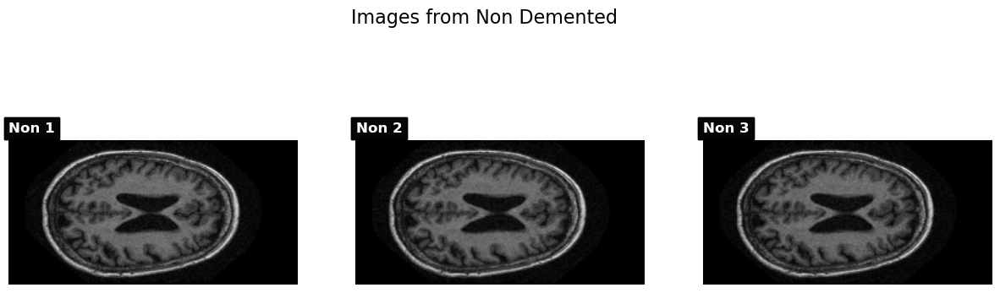

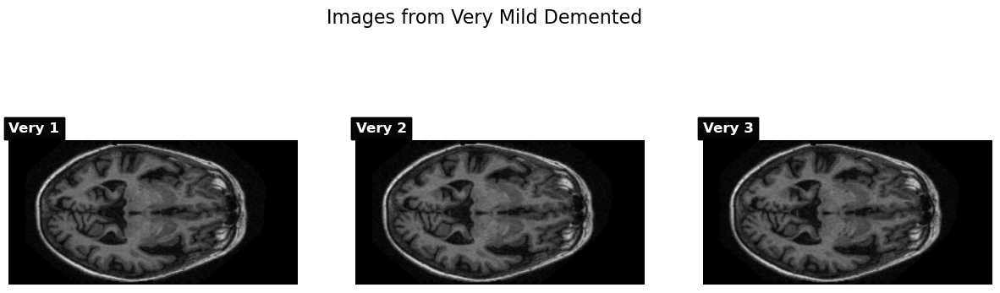

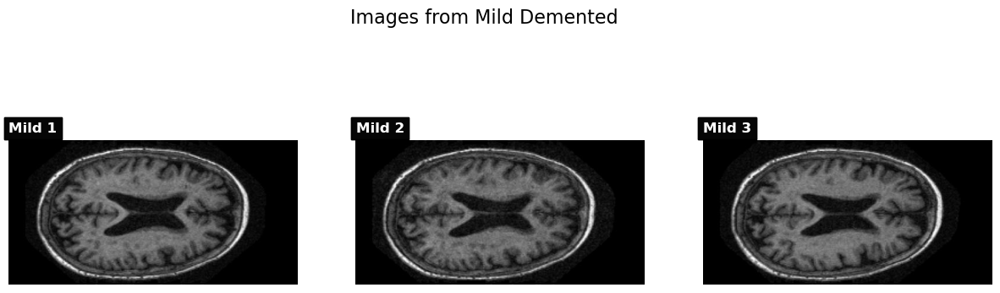

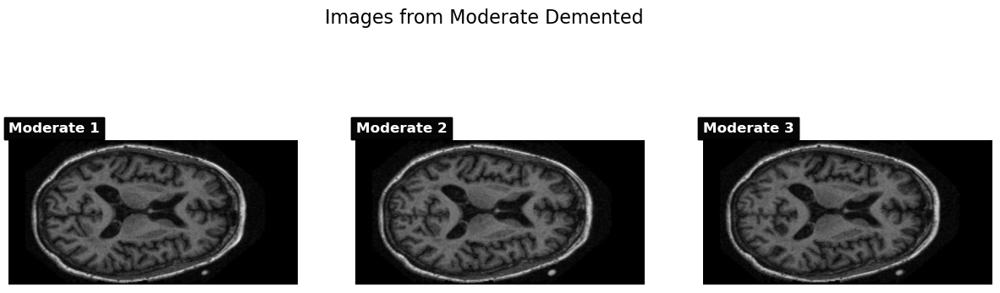

In [4]:
# Function to display images with text indicating the category
def display_images_with_text(file_paths, category_name, endings=['150', '151', '152']):
    plt.figure(figsize=(15, 5))
    plt.suptitle(f"Images from {category_name}", fontsize=16)

    for ending in endings:
        matching_files = [img for img in file_paths if img.endswith(ending + '.jpg')]
        for i in range(min(3, len(matching_files))):
            img_path = matching_files[i]
            img = Image.open(img_path)
            plt.subplot(1, 3, i + 1)
            plt.imshow(img)
            plt.axis('off')
            
            # Add text indicating the category
            plt.text(0, -10, f"{category_name.split()[0]} {i + 1}", color='white', fontsize=12, weight='bold', ha='left', va='bottom', bbox=dict(facecolor='black', alpha=0.7))

    plt.show()

# Display images with text for each category
display_images_with_text(non_demented, "Non Demented")
display_images_with_text(very_mild_demented, "Very Mild Demented")
display_images_with_text(mild_demented, "Mild Demented")
display_images_with_text(moderate_demented, "Moderate Demented")

## 2. Exploratory Data Analysis (EDA)

We conducted an Exploratory Data Analysis (EDA) to see what our data looks like. 

### 2.1 Extracting Variables 

#### 2.1.1 patient_id, mr_id, scan_id, layer_id

* This defines a regular expression pattern using re.compile.
* The pattern includes capturing groups for the patient_id, mr_id, scan_id, and layer_id.
* It attempts to match the pattern with the provided filename using pattern.match(filename).
* If there is a match, the function extracts the values from the capturing groups using match.group(n) where n is the group number.

In [5]:
def get_info_from_filename(filename):
    pattern = re.compile('OAS1_(\d+)_MR(\d+)_mpr-(\d+)_(\d+).jpg')
    match = pattern.match(filename)
    patient_id = match.group(1)
    mr_id = match.group(2)
    scan_id = match.group(3)
    layer_id = match.group(4)

    return patient_id, mr_id, scan_id, layer_id

#### 2.1.2 path, label, parient_id, mr_id, scan_id, layer_id

The create_ref_df function takes a dataset_path as input, iterates through the files in the specified directory structure, extracts information from the filenames using the get_info_from_filename function, and creates a pandas DataFrame (ref_df) with columns for the path, label, patient_id, mr_id, scan_id, and layer_id.

In [6]:
def create_ref_df(dataset_path):
    paths, labels = [], []
    patient_ids, mr_ids, scan_ids, layer_ids = [], [], [], []

    # Iterate through folders in the dataset_path
    for folder in os.listdir(dataset_path):
        
        # Iterate through files in each folder
        for file in os.listdir(os.path.join(dataset_path, folder)):

            # Extract information from the filename using get_info_from_filename function
            patient_id, mr_id, scan_id, layer_id = get_info_from_filename(file)

            # Append information to respective lists
            paths.append(os.path.join(dataset_path, folder, file))
            labels.append(folder)
            patient_ids.append(patient_id)
            mr_ids.append(mr_id)
            scan_ids.append(scan_id)
            layer_ids.append(layer_id)

    # Create a DataFrame from the collected information
    ref_df = pd.DataFrame({
        'path': paths,
        'label': labels,
        'patient_id': patient_ids,
        'mr_id': mr_ids,
        'scan_id': scan_ids,
        'layer_id': layer_ids
    })

    # Convert columns to appropriate data types
    ref_df = ref_df.astype({
        'path': 'string',
        'label': 'string',
        'patient_id': 'int64',
        'mr_id': 'int64',
        'scan_id': 'int64',
        'layer_id': 'int64'
    })

    return ref_df

In [7]:
# Applying the function defined above
ref_df = create_ref_df('C:/Users/Drenica/OneDrive - Saint Peters University/Desktop/archive/Data')

### 2.2 Loading Images with Labels and Paths

In [8]:
def load_images(ref_df):
    labels = []
    images = []
    paths = []

    # Iterate through rows of the reference DataFrame
    for idx, row in tqdm(ref_df.iterrows(), total=ref_df.shape[0]):
        
        # Load image using PIL and convert it to a grayscale numpy array
        images.append(np.array(Image.open(row['path']).convert('L')))
        
        # Append label and path to respective lists
        labels.append(row['label'])
        paths.append(row['path'])
    
    # Return lists of images, labels, and paths
    return images, labels, paths

In [9]:
# Applying the function defined above
images, labels, paths = load_images(ref_df)

100%|████████████████████████████████████████████████████████████████████████████| 86437/86437 [34:19<00:00, 41.97it/s]


In [10]:
#from PIL import Image
#import numpy as np
#from tqdm import tqdm

#def load_images(ref_df, max_size=(256, 256)):
#   labels = []
#  images = []
#    paths = []

#    for idx, row in tqdm(ref_df.iterrows(), total=ref_df.shape[0]):
#        # Load and resize image
#        img = Image.open(row['path']).convert('L')
#        img = resize_image(img, max_size=max_size)  # Resize image
        
#        images.append(np.array(img))
#        labels.append(row['label'])
#        paths.append(row['path'])

#    return images, labels, paths

### 2.3 Extracting Image Statistics

The following statistics were extracted:

* **mean:** Mean pixel value of each image.
* **std:** Standard deviation of pixel values in each image.
* **width:** Width of each image.
* **height:** Height of each image.
* **skew:** Skewness of the histogram of pixel values in each image.

In [11]:
def get_image_stats(images, labels, paths):
    means, stds, widths, heights = [], [], [], []
    skewnesses = []
    
    # Iterate through the images
    for image in tqdm(images):
        
        # Calculate mean and standard deviation
        means.append(np.mean(image))
        stds.append(np.std(image))
        
        # Get image width and height
        widths.append(image.shape[0])
        heights.append(image.shape[1])
        
        # Calculate skewness of the image histogram
        image_hist = np.histogram(image.flatten())[0]
        skewnesses.append(skew(image_hist))
    
    # Create a DataFrame with image statistics
    image_stats = pd.DataFrame({
        'mean': means,
        'std': stds,
        'width': widths,
        'height': heights,
        'skew': skewnesses
    })
    
    # Add labels and paths to the DataFrame
    image_stats['label'] = labels
    image_stats['path'] = paths
    
    return image_stats

In [12]:
# Applying the function defined above
image_stats = get_image_stats(images, labels, paths)

100%|████████████████████████████████████████████████████████████████████████████| 86437/86437 [21:43<00:00, 66.31it/s]


### 2.4 Label Distribution

Below we plotted the distribution of the classes as a bar chart. 

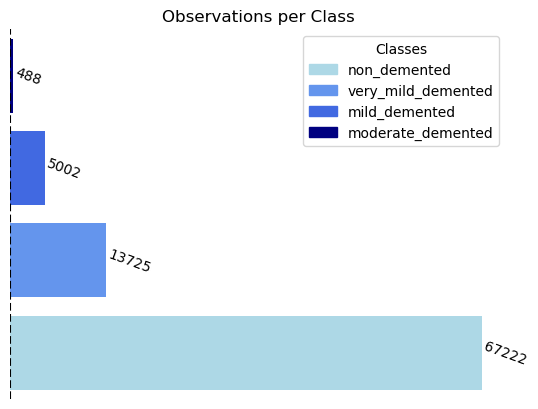

In [13]:
# Defining class_names, frequencies
frequencies = [len(non_demented),  len(very_mild_demented), len(moderate_demented), len(mild_demented),]
class_names = ["non_demented", "very_mild_demented", "moderate_demented", "mild_demented"]

# Sorting class_names and frequencies in descending order
sorted_indices = np.argsort(frequencies)[::-1]
class_names = np.array(class_names)[sorted_indices]
frequencies = np.array(frequencies)[sorted_indices]

# Navy blue gradient color palette with 4 distinct colors
navy_blue_palette = LinearSegmentedColormap.from_list("navy_blue_palette", ["lightblue", "cornflowerblue", "royalblue", "navy"], N=4)

# Bar plot with adjusted y-axis limits and navy blue gradient colors
fig, ax = plt.subplots()
bp = ax.barh(np.arange(len(class_names)), frequencies, color=navy_blue_palette(np.linspace(0, 1, len(class_names))))

# Adjusted y-axis limits
ax.set_ylim(-0.5, len(class_names)-0.5)

# Class names as y-axis labels
ax.set_yticks(np.arange(len(class_names)))
ax.set_yticklabels(class_names)

# Hide axes
ax.axis('off')

# Frequency values to the right of each bar with a reduced offset
for i, frequency in enumerate(frequencies):
    ax.text(frequency + 0.1, i, frequency, ha='left', va='center', rotation=-20)

# Vertical line at 0 for clarity
ax.axvline(x=0, linestyle='--', color='black')

# Legend
handles = [plt.Rectangle((0, 0), 1, 1, color=navy_blue_palette(i)) for i in range(4)]
ax.legend(handles, class_names, loc="upper right", title="Classes")

# Plot title
plt.title("Observations per Class")

plt.show()

Here, a **substantial class imbalance** can be clearly seen, where certain classes significantly outnumber others (**Non Demented >> Very mild Dementia > Mild Dementia >> Moderate Dementia**). This imbalance poses challenges for convolutional neural networks, as they may become biased toward the majority class and struggle to effectively recognize and classify instances from the minority classes. Addressing this class imbalance is crucial for building a robust and unbiased model.

Techniques such as oversampling the minority class, undersampling the majority class, or using advanced methods like Synthetic Minority Over-sampling Technique (SMOTE) can be employed to mitigate these challenges and enhance the model's performance on the underrepresented classes. We tried out several of these methods and finally chose for a mix of over- and undersampling (see 3.2). 

Additionally, careful consideration should be given to appropriate evaluation metrics that account for the class imbalance, such as precision, recall, and F1 score, rather than relying solely on accuracy (see 6). 

### 2.5 Mean, SD and Skewness of Images

We visualized the mean, standard deviation and skewness of the images with boxplots. 

In [14]:
# Boxplot of image histogram Means
px.box(image_stats, y='mean', x='label')

In [15]:
# Boxplot of image histogram SDs
px.box(image_stats, y='std', x='label')

In [16]:
# Boxplot of image histogram Skewness
px.box(image_stats, y='skew', x='label')

Upon examining scatter plots and box charts, a notable trend emerges: as the severity of dementia increases, the statistical features such as mean, standard deviation, and skew of the images appear to cluster within a more confined range.

Furthermore, there is an observable upward trend in skewness with increasing severity. While not definitive, these insights suggest that leveraging these statistical features could potentially serve to improve and expedite the training process of a deep learning model.

## 3. Data Pre-Processing

### 3.1 Splitting Off a Test Set

Before we do any preprocessing, we split off a test set of images for each category so that we can evaluate the model on data that it has never seen before, and that we also did not tune the hyperparameters on. This will give a more accurate representation of our model's actual performance. 

In [17]:
# Set seed for random sampling
random.seed(42)


# Split off a test set for the moderate_demented class
moderate_demented_train, moderate_demented_test = train_test_split(
    moderate_demented, test_size=0.2, random_state=42
)

# Split off a test set for the mild_demented class
mild_demented_train, mild_demented_test = train_test_split(
    mild_demented, test_size=0.2, random_state=42
)

# Split off a test set for the very_mild_demented class
very_mild_demented_train, very_mild_demented_test = train_test_split(
    very_mild_demented, test_size=0.2, random_state=42
)

# Split off a test set for the non_demented class
non_demented_train, non_demented_test = train_test_split(
    non_demented, test_size=0.2, random_state=42
)

### 3.2 Handling Class Imbalance

As mentioned in the introduction and visible in our ‘Observations per Class’ histogram, our dataset was extremely imbalanced, with the minority class being only 0.007% the size of the majority class. Although the dataset’s class proportions reflect current prevalence of Alzheimer’s per category (with more severe forms of the disease naturally being less frequent than no diagnosis), this was not ideal in terms of neural network training. Datasets with such high imbalance can result in misleading outputs such as high performance on the majority class but low on the minority class, and deceptive performance interpretations when using common performance metrics such as accuracy (as it is often not suited for class imbalance). To this end, researching ways of countering this was one of our initial priorities.

The most problematic part of our case of class imbalance was the fact that we were working with medical brain scans. It is highly inadvisable to perform data augmentation through common techniques such as distortions, rotations, color changes, and even flips to medical data, as this could lead to potentially losing valuable information about brain structures along the way, and lead to erroneous diagnoses. Given the (medical) importance and implications of diagnosis, it would be too big a risk (and  potentially unethical) to include such transformations to our data. Therefore, our ways of dealing with imbalance were quite limited, specifically in terms of augmentation.

We initially looked into data augmentation using SMOTE, weighted classes, undersampling, oversampling, and a weighted loss function. SMOTE was not applicable to our dataset; subsequently we compared performance using weighted classes to performance using a **combination of undersampling (of the majority classes) and oversampling (of the minority classes)**. The former yielded very poor accuracy (probably because a large weight is given to the minority class so small discrepencies become very influential) whereas the latter performed extremely well, and is what we have chosen for our final (highly performing) model. Given the poor performance of weighted classes and its technical difficulty we opted to not include weighted loss functions. 

Since oversampling involves resampling and using images from the dataset without changes (and hence using replicas of images to augment a class), before implementing it we split off a test set from each class’ raw data. This resulted in 98 images from the moderate class (20% of the 488 observations), and 640 images for the other 3 categories, to end up with **2000 images** for the test set, which is 10% of the train sample size consisting of **20,000 images**. It was not an issue that the test dataset was not proportional across classes, as it is appropriate for a test set to include a proportion that is closer to real-world occurrence of each class (in this case a lower incidence of “moderate” Alzheimer’s) rather than proportional for every class, as this will mirror more closely how the test fares for realistic diagnostic prediction. Then, with the remaining data, we undersampled from the two majority classes to obtain 5000 scans per class, and oversampled from the two minority classes to get 5000 images for each as well. We then performed an 80-20 train-validation split on this 20,000 image set, such that we had 16,000 images for training (4000 per class), and 4000 for validation (1000 per class). This is the data we used to train our model. 

#### 3.2.1 Under-/Oversampling Train Data 

In [18]:
# Check number of train images per category
print(len(non_demented_train))
print(len(very_mild_demented_train))
print(len(mild_demented_train))
print(len(moderate_demented_train))

53777
10980
4001
390


In [19]:
# Specify the target number of samples for each class
target_samples = 5000

# Oversample small classes
moderate_demented_samp = random.choices(moderate_demented_train, k=target_samples)
mild_demented_samp = random.choices(mild_demented_train, k=target_samples)

# Undersample large classes
very_mild_demented_samp = random.sample(very_mild_demented_train, k=target_samples)
non_demented_samp = random.sample(non_demented_train, k=target_samples)

In [20]:
# Check results
print(len(non_demented_samp))
print(len(very_mild_demented_samp))
print(len(mild_demented_samp))
print(len(moderate_demented_samp))

5000
5000
5000
5000


#### 3.2.2 Undersampling Test Data 

In [21]:
# Check the number of test images per category
print(len(non_demented_test))
print(len(very_mild_demented_test))
print(len(mild_demented_test))
print(len(moderate_demented_test))

13445
2745
1001
98


In [22]:
# Specify the target number of samples for each class
target_samples = 640

# Undersample large classes
mild_demented_test = random.sample(mild_demented_test, k=target_samples)
very_mild_demented_test = random.sample(very_mild_demented_test, k=target_samples)
non_demented_test = random.sample(non_demented_test, k=target_samples)

### 3.3 Merging, Shaping, Splitting

#### 3.3.1 One-Hot Encoder 

We needed a function to one-hot encode the class labels. 

In [23]:
# One-hot encoder for class labels 
encoder = OneHotEncoder()
encoder.fit([[0],[1],[2],[3]])

OneHotEncoder()

#### 3.3.2 Train Data 

We transformed the train images from each class into the preferred shape: 128x128x3. We choose 128 pixels to reduce computation time. The categories were merged together into the 'data' object. The class labels were transformed into the one-hot encoded format and stored into the 'result' object. 

After this, we splitted this data into a training set (80%) and a validation set (20%). 

In [24]:
# Empty objects to store the data and the class labels (result) in
data = []
result = []

# Loop through each category and transform data and result into right format (128x128x3 & one-hot encoded) 
# and merge categories together
for path in non_demented_samp:
    img = Image.open(path)
    img = img.resize((128,128))
    img = np.array(img)
    if(img.shape == (128,128,3)):
        data.append(np.array(img))
        result.append(encoder.transform([[0]]).toarray())

for path in very_mild_demented_samp:
    img = Image.open(path)
    img = img.resize((128,128))
    img = np.array(img)
    if(img.shape == (128,128,3)):
        data.append(np.array(img))
        result.append(encoder.transform([[1]]).toarray())
        
for path in mild_demented_samp:
    img = Image.open(path)
    img = img.resize((128,128))
    img = np.array(img)
    if(img.shape == (128,128,3)):
        data.append(np.array(img))
        result.append(encoder.transform([[2]]).toarray()) 
        
for path in moderate_demented_samp:
    img = Image.open(path)
    img = img.resize((128,128))
    img = np.array(img)
    if(img.shape == (128,128,3)):
        data.append(np.array(img))
        result.append(encoder.transform([[3]]).toarray())

In [25]:
# Transform data to numpy array
data = np.array(data)

# Check shape
data.shape

(20000, 128, 128, 3)

In [26]:
# Transform labels to numpy array
result = np.array(result)

# Reshape to the one-hot encoded format 
result = result.reshape((data.shape[0],4)) 

# Check shape 
result.shape

(20000, 4)

In [28]:
# Split in validation and train data 
x_train,x_val,y_train,y_val = train_test_split(data,result, test_size=0.20, shuffle=True, random_state=42)

MemoryError: Unable to allocate 188. MiB for an array with shape (4000, 128, 128, 3) and data type uint8

#### 3.3.3 Test Data 

Also for the test data, we transformed the images from each class into the preferred shape (128x128x3) and merged the categories together into the 'data_test' object. Again, the class labels were transformed into the one-hot encoded format and stored into the 'result_test' object. 

In [ ]:
### Transforming the data into the right shape (128x128x3), merge and encode it 

data_test = []
result_test = []

for path in non_demented_test:
    img = Image.open(path)
    img = img.resize((128,128))
    img = np.array(img)
    if(img.shape == (128,128,3)):
        data_test.append(np.array(img))
        result_test.append(encoder.transform([[0]]).toarray())
        
for path in very_mild_demented_test:
    img = Image.open(path)
    img = img.resize((128,128))
    img = np.array(img)
    if(img.shape == (128,128,3)):
        data_test.append(np.array(img))
        result_test.append(encoder.transform([[1]]).toarray())
        
for path in mild_demented_test:
    img = Image.open(path)
    img = img.resize((128,128))
    img = np.array(img)
    if(img.shape == (128,128,3)):
        data_test.append(np.array(img))
        result_test.append(encoder.transform([[2]]).toarray()) 
        
for path in moderate_demented_test:
    img = Image.open(path)
    img = img.resize((128,128))
    img = np.array(img)
    if(img.shape == (128,128,3)):
        data_test.append(np.array(img))
        result_test.append(encoder.transform([[3]]).toarray())

In [ ]:
# Transform data to numpy array
data_test = np.array(data_test)
data_test.shape

In [ ]:
# Transform labels to numpy array
result_test = np.array(result_test)
result_test = result_test.reshape((data_test.shape[0],4)) 
result_test.shape

We changed the names of 'data_test' to 'x_test' and 'result_test' to 'y_test' for the sake of consistency. 

In [ ]:
# Change names to x_test and y_test 
x_test = data_test
y_test = result_test

The data pre-processing thus resulted in the following data objects:
- x_train: train data
- y_train: train labels
- x_val: validation data (used in training/modeling)
- y_val: validation labels (used in training/modeling)
- x_test: test data (evaluation after modeling)
- y_test: test labels (evaluation after modeling)

## 4. Modeling

Because our task involved classifying MRI images into four ordinal categories, we adopted a Convolutional Neural Network specifically designed for ordinal classification. We then compared this model to a CNN for 'regular' classification, to see if the ordinality in the data is better represented by an ordinal classifier CNN. 

### 4.1 Ordinal vs. Regular Classification

Thus, in our data the classes have a meaningful order. To keep this information in tact, it is typically recommended to use a loss function that is specifically designed for this, and (optionally) adding a special output layer to the model. We tried several custom loss functions and output layers, such as a bias layer - in which the last layer shares its weights but has different biases - or a CORAL (consistent rank logits) layer (Cao et al., 2019). Unfortunately, much of these did not work for our specific data set and task, or resulted in extremely low performance. Hence, we instead opted for encoding the class labels as **integers representing the ordinal classes** (0: non-demented; 1: very mild demented; 2: mild demented; 3: moderate demented) instead of one-hot encoded vectors, as is done in regular classification where there is no natural order in the classes. This way, the ordinal information in the labels is maintained, i.e., class 2 (mild demented) is 'more demented' than class 1 (very mild demented). Additionally, we used a **sparse categorical crossentropy** as a loss function, which computes the crossentropy between the predicted probability distribution and the true integer labels. This is opposed to a 'regular' categorical crossentropy used in regular classification, which takes in one-hot encoded class labels. 

In [ ]:
# Convert labels to integers
y_train_int = np.argmax(y_train, axis=1)
y_val_int = np.argmax(y_val, axis=1)

In [ ]:
from tensorflow.keras.applications import ResNet50
from tensorflow.keras import models, layers, optimizers

### 4.2 Model Architecture 

In [ ]:
# Load the pre-trained InceptionV3 model
pretrained_base_InceptionV3 = InceptionV3(weights='imagenet', include_top=False, input_shape=(299, 299, 3))
pretrained_base_InceptionV3.trainable = True

# Custom model on top of InceptionV3
model_InceptionV3 = models.Sequential([
    pretrained_base_InceptionV3,
    layers.BatchNormalization(),
    layers.GlobalAveragePooling2D(),
    layers.Dense(512, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(4, activation='softmax')
])

model_InceptionV3.compile(optimizer=Adam(learning_rate=0.001),
                          loss='sparse_categorical_crossentropy',
                          metrics=['accuracy'])


# Summary of the model
model_InceptionV3.summary()

### 4.3 Training: Ordinal Classification

First, we optimized and trained the model for ordinal classification (which involved predicting **integer labels** and deploying **sparse crossentropy loss**). We used **accuracy** as a performance metric, which is valid because there is no more class imbalance (see 6 for other metrics). We also included an **early stopping** callback, which makes the model quit training when the validation loss stops improving, thereby avoiding training for too many epochs which could lead to overfitting. We set the patience to 5, meaning that training will stop if there is no improvement in validation loss for 5 consecutive epochs. The minimum delta value is set to 0.0001, which is the minimum change in validation loss to qualify as improvement. 

In [ ]:
# Use integer labels: y_train_int & y_val_int

# Adam optimizer with learning rate 0.001
optimizer = Adam(learning_rate=0.001)

# Compile the model
model_InceptionV3.compile(optimizer=optimizer, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Define early stopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=5, min_delta=0.0001, restore_best_weights=True)

# Train the model with early stopping
history_InceptionV3 = model_InceptionV3.fit(x_train, y_train_int, epochs=50, batch_size=16,
                                                  verbose=1, validation_data=(x_val, y_val_int), callbacks=[early_stopping])


### 4.4 Training: Regular Classification

As explained, to see if the model that is specifically trained for ordinal classification performs better, we compared it to the training of the model for regular classification. For this we used the **same architecture** and performance metric (**accuracy**), but with 'regular' **categorical crossentropy** as loss function and the labels as **one-hot vectors**. Again, we used **early stopping** to prevent overfitting. 

In [ ]:
# Store model architecture in new object, to prevent confusion (e.g. with compiling, training and calculating test accuracy later)
# By cloning the model
model_InceptionV3_rc = clone_model(model_InceptionV3)

# Adam optimizer with learning rate 0.001
optimizer = Adam(learning_rate=0.001)

# Compile with ('regular') categorical_crossentropy 
model_InceptionV3_rc.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

# Define early stopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=5, min_delta=0.0001, restore_best_weights=True)

# Train
history_InceptionV3_rc = model_InceptionV3_rc.fit(x_train, y_train, epochs=50, batch_size=16, 
                                                       verbose=1, validation_data=(x_val, y_val), callbacks=[early_stopping])

# Results

To examine the performance of our model and compare ordinal with regular classification, we calculated several performance metrics on the validation and test data. 

## 5. Results on Train and Validation Data

To have a first glance at the model's performance, we plotted the loss and accuracy of the validation data and inspected the convergence, for both the ordinal and regular classification.  

### 5.1 Loss & Accuracy Ordinal Classification 

In [ ]:
import matplotlib.pyplot as plt

plt.plot(history_InceptionV3.history['accuracy'], label='accuracy')
plt.plot(history_InceptionV3.history['val_accuracy'], label='val_accuracy')
plt.legend()
plt.show()

In [ ]:
import matplotlib.pyplot as plt

plt.plot(history_InceptionV3.history['loss'], label='loss')
plt.plot(history_InceptionV3.history['val_loss'], label='val_loss')
plt.legend()
plt.show()

In [ ]:
# Loss & accuracy of ordinal model 
history_InceptionV3_frame = pd.DataFrame(history_InceptionV3.history)
history_InceptionV3_frame.loc[:, ['loss', 'val_loss']].plot()
history_InceptionV3_frame.loc[:, ['accuracy', 'val_accuracy']].plot()

### 5.2 Loss & Accuracy Regular Classification 

In [ ]:
# Loss & accuracy of regular model 
history_InceptionV3_rc_frame = pd.DataFrame(history_InceptionV3_rc.history)
history_InceptionV3_rc_frame.loc[:, ['loss', 'val_loss']].plot()
history_InceptionV3_rc_frame.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
import matplotlib.pyplot as plt

# Plot training & validation loss values
plt.figure(figsize=(10, 5))
plt.plot(history_InceptionV3_rc_frame.history['loss'], label='Train Loss')
plt.plot(history_InceptionV3_rc_frame.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(loc='upper right')
plt.show()

# Plot training & validation accuracy values
plt.figure(figsize=(10, 5))
plt.plot(history_InceptionV3_rc_frame.history['accuracy'], label='Train Accuracy')
plt.plot(history_InceptionV3_rc_frame.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='upper left')
plt.show()

## 6. Results on Test Data: Ordinal Classification

We also investigated the model's performance on data that it has never seen before and wasn't tuned on: the test dataset. We used accuracy and loss, which are valid measures because the class imbalance was taken care of. Nevertheless, to be able to be more confident about the results, we calculated other metrics as well, including a measure that is presumably the most optimal for ordinal classification (Scott's pi; Yilmaz & Demirhan, 2023; see 6.5). 

- Accuracy
- Loss
- Confusion matrix (log scale)
- F1 score
- Precision
- Recall
- ROC-AUC
- Scott's pi 

### 6.1 Accuracy & Loss

We calculated the accuracy and loss scores of the model trained for ordinal classification. 

In [ ]:
# Convert true test labels to integers
y_test_int = np.argmax(y_test, axis=1)

# Evaluate on test set 
testeval = model_InceptionV3.evaluate(x_test, y_test_int, verbose=2)

# Print performance metrics (loss and accuracy)
print("Test Loss:", testeval[0])
print("Test Accuracy:", testeval[1])

### 6.2 Confusion Matrix (Log Scale)

We examined the confusion matrix to have a look at the true and false positives and negatives. Confusion matrices help identify specific areas in which the model may perform worse. Using a log scale makes it easier to spot these areas. (See 8. Robustness Analysis for an elaboration.) 

In [ ]:
# Use integer test labels: y_test_int

# Convert predicted labels to integers 
y_pred_int = np.argmax(model_InceptionV3.predict(x_test), axis=1)

# Create confusion matrix
cm = confusion_matrix(y_test_int, y_pred_int)

# Plot confusion matrix on log scale
plt.figure(figsize=(8, 6))
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues, norm=LogNorm())
plt.title('Confusion Matrix (Log Scale)')
plt.colorbar()
classes = np.unique(y_test_int)
tick_marks = np.arange(len(classes))
plt.xticks(tick_marks, classes, rotation=45)
plt.yticks(tick_marks, classes)

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

### 6.3 F1 Score, Precision, Recall 

To examine the model's performance we computed a precision, recall and F1 score. These metrics are more nuanced than accuracy, because they take into account positive as well negative predictions. 

- Precision measures the accuracy of positive predictions. It focusses on higher-ranked categories. 
- Recall measures the true positive rate and is analogous to sensitivity. It  focusses on lower-ranked categories.
- F1 score combines precison and recall. It focusses on false positives and false negatives. 

The F1 score, precision and recall are all metrics that are originally designed for a binarity setting, but they can easily be translated to a multiclass setting and to ordinal classification. This is done by first considering each class individually, and then computing a micro-average, in which one simply computes the average of the individual class scores. The micro-average method assigns equal weight to each class, treating the problem as a binary classification problem for each class. This is the most optimal method for our task because there is no more class imbalance due to resampling (as compared to a weighted average or macro-average which are more suitable for imbalanced data). 
Additionally, we are interested in overall performance and want to treat the problem as a whole. 

In [ ]:
# Predicted integer labels: y_pred_int

# One-hot encode the predicted labels
y_pred_one_hot = to_categorical(y_pred_int, num_classes=4)

# True labels one hot encoded: y_test

# True labels integers: y_test_int

# Calculate precision, recall, and F1 score per class --> uses integers
precision, recall, f1, _ = precision_recall_fscore_support(y_test_int, y_pred_int, average=None)

# Print precision, recall, and F1 score for each class
for i, (p, r, f) in enumerate(zip(precision, recall, f1)):
    print(f'Class {i}: Precision = {p:.4f}, Recall = {r:.4f}, F1 Score = {f:.4f}')
    
# Calculate micro-averages --> uses one hot encoded labels
micro_precision, micro_recall, micro_f1, _ = precision_recall_fscore_support(y_test, y_pred_one_hot, average='micro')

# Print precision, recall and F1 score micro average
print("Micro-average Precision:", round(micro_precision, 4))
print("Micro-average Recall:", round(micro_recall, 4))
print("Micro-average F1 Score:", round(micro_f1, 4))


### 6.4 ROC-AUC score

The ROC-AUC score was also calculated. ROC-AUC is also designed for a binary classification setting, but again can be easily translated to a multiclass (ordinal) setting by computing the score per class and calculating the micro-average. The ROC-AUC indicates the model's overall performance and considers the true positive and false positive rate. 

In [ ]:
# True labels: y_test

# Predicted probability scores for each class
y_probs = model_InceptionV3.predict(x_test)

# Calculate ROC AUC per class
roc_auc_per_class = roc_auc_score(y_test, y_probs, multi_class='ovr', average=None)

# Print ROC AUC for each class
for i, auc in enumerate(roc_auc_per_class):
    print(f'Class {i}: ROC AUC = {auc:.4f}')

# Calculate micro-average ROC AUC
roc_auc_micro = roc_auc_score(y_test, y_probs, multi_class='ovr', average='micro')

# Print
print("Micro-average ROC AUC:", round(roc_auc_micro, 4))

### 6.5 Scott's Pi 

Lastly, Scott's pi was computed as a measure of test performance. This was done because the other metrics - even though they were adapted for ordinal classification by calculating scores per class and computing the micro-average - may not fully capture the ordinal relationship between the classes. According to a study done by Yilmaz and Demirhan (2023) in which several performance measures for ordinal classification were compared, Scott's pi is best to use for these kind of tasks. It is originally a measure for inter-rater reliability, but it is also very suitable for ordinal tasks like ours because it considers the ordinality of the data. Scott's pi is interpreted in the same manner as accuracy, with scores closer to 1 indicating good performance (Yilmaz & Demirhan, 2023). 

In [ ]:
# Scott's pi function
def scotts_pi(confusion_matrix):
    total = np.sum(confusion_matrix)
    observed_agreement = np.trace(confusion_matrix)
    
    row_totals = np.sum(confusion_matrix, axis=1)
    col_totals = np.sum(confusion_matrix, axis=0)
    
    expected_agreement = np.sum((row_totals * col_totals) / total)
    
    pe = expected_agreement / total
    pi = (observed_agreement - expected_agreement) / (total - expected_agreement)
    
    return pi


# True integer labels: y_test_int
y_test_int = np.argmax(y_test, axis=1)

# Predicted integer labels: y_pred_int

# Calculate confusion matrix
conf_matrix = confusion_matrix(y_test_int, y_pred_int)

# Calculate Scott's Pi
pi = scotts_pi(conf_matrix)
print("Scott's Pi:", pi)

## 7. Results on Test Data: Regular Classification

The aforementioned metrics were also calculated for the regular classification model, to compare it with the results from the ordinal clasification model. 

*Please note that for some of these metrics, integer labels instead of one-hot encoded ones had to be used.*

### 7.1 Accuracy & Loss 

In [ ]:
# Evaluate on test set 
testeval = model_InceptionV3_rc.evaluate(x_test, y_test, verbose=2)

# Print performance metrics (loss and accuracy)
print("Test Loss:", testeval[0])
print("Test Accuracy:", testeval[1])

### 7.2 Confusion Matrix (Log Scale)

In [ ]:
# Predicted labels, convert to integer: 
y_pred_rc_int = np.argmax(model_InceptionV3_rc.predict(x_test), axis=1)

# True integer labels: y_test_int

# Create confusion matrix
cm = confusion_matrix(y_test_int, y_pred_rc_int)

# Plot confusion matrix on log scale
plt.figure(figsize=(8, 6))
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues, norm=LogNorm())
plt.title('Confusion Matrix (Log Scale)')
plt.colorbar()
classes = np.unique(y_test)
tick_marks = np.arange(len(classes))
plt.xticks(tick_marks, classes, rotation=45)
plt.yticks(tick_marks, classes)

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

### 7.3 F1 Score, Precision, Recall 

In [ ]:
# Predicted integer labels: y_pred_rc_int

# One-hot encode the predicted labels
y_pred_rc = to_categorical(y_pred_rc_int, num_classes=4)

# True labels one hot encoded: y_test

# True integer labels: y_test_int

# Calculate precision, recall, and F1 score per class (uses integers)
precision, recall, f1, _ = precision_recall_fscore_support(y_test_int, y_pred_rc_int, average=None)

# Print precision, recall, and F1 score for each class
for i, (p, r, f) in enumerate(zip(precision, recall, f1)):
    print(f'Class {i}: Precision = {p:.4f}, Recall = {r:.4f}, F1 Score = {f:.4f}')
    
# Calculate micro-averages (uses one hot encoded labels)
micro_precision, micro_recall, micro_f1, _ = precision_recall_fscore_support(y_test, y_pred_rc, average='micro')

# Print precision, recall and F1 score micro average
print("Micro-average Precision:", round(micro_precision, 4))
print("Micro-average Recall:", round(micro_recall, 4))
print("Micro-average F1 Score:", round(micro_f1, 4))

### 7.4 ROC-AUC Score 

In [ ]:
# True labels: y_test

# Predicted probability scores for each class
y_probs_rc = model_InceptionV3_rc.predict(x_test)

# Calculate ROC AUC per class
roc_auc_per_class = roc_auc_score(y_test, y_probs_rc, multi_class='ovr', average=None)

# Print ROC AUC for each class
for i, auc in enumerate(roc_auc_per_class):
    print(f'Class {i}: ROC AUC = {auc:.4f}')

# Calculate micro-average ROC AUC
roc_auc_micro = roc_auc_score(y_test, y_probs_rc, multi_class='ovr', average='micro')

# Print
print("Micro-average ROC AUC:", round(roc_auc_micro, 4))

### 7.5 Scott's Pi

Although Scott's pi is a performance measure best suitable for ordinal classification (Yilmaz & Demirhan, 2023), we also calculated it on our regular classification model. 

In [ ]:
# Scott's pi function: scotts_pi

# Predicted integer labels: y_pred_rc_int

# True integer labels: y_test_int

# Create confusion matrix
conf_matrix = confusion_matrix(y_test_int, y_pred_rc_int)

# Calculate Scott's Pi
pi = scotts_pi(conf_matrix)
print("Scott's Pi:", pi)